# **Implementing conditional GANs**

Imagine a scenario where we want to generate an image of a class of our interest; for
example, an image of a cat or an image of a dog, or an image of a man with spectacles.
How do we specify that we want to generate an image of interest to us? Conditional
GANs come to the rescue in this scenario.

In this notebook, we will learn about generating images
of a specified class of interest from random noise

**The strategy we adopt is as follows:**
1. Specify the label of the image we want to generate as a one-hot-encoded
version.
2. Pass the label through an embedding layer to generate a multi-dimensional
representation of each class.
3. Generate random noise and concatenate with the embedding layer
generated in the previous step.
4. Train the model just like we did in the previous notebook, but this time with
the noise vector concatenated with the embedding of the class of image we
wish to generate.

# **Problem got in paperspace gradient solved by following code**
> unable to install [opencv](https://community.paperspace.com/t/guide-how-to-install-opencv-on-a-gradient-notebook/1644)


`sudo apt-get install -y whatever` without concern about [Y/N?] warning!

In [1]:
# cat /etc/*-release

In [2]:
!apt-get update

Hit:1 http://archive.ubuntu.com/ubuntu focal InRelease
Hit:2 http://security.ubuntu.com/ubuntu focal-security InRelease
Hit:3 http://archive.ubuntu.com/ubuntu focal-updates InRelease
Hit:4 http://archive.ubuntu.com/ubuntu focal-backports InRelease
Reading package lists... Done


In [3]:
!apt install -y libgl1-mesa-glx

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  libdrm-amdgpu1 libdrm-common libdrm-intel1 libdrm-nouveau2 libdrm-radeon1
  libdrm2 libelf1 libgl1 libgl1-mesa-dri libglapi-mesa libglvnd0 libglx-mesa0
  libglx0 libllvm12 libpciaccess0 libsensors-config libsensors5 libvulkan1
  libwayland-client0 libx11-6 libx11-data libx11-xcb1 libxau6 libxcb-dri2-0
  libxcb-dri3-0 libxcb-glx0 libxcb-present0 libxcb-randr0 libxcb-shm0
  libxcb-sync1 libxcb-xfixes0 libxcb1 libxdmcp6 libxext6 libxfixes3
  libxshmfence1 libxxf86vm1 mesa-vulkan-drivers
Suggested packages:
  pciutils lm-sensors
The following NEW packages will be installed:
  libdrm-amdgpu1 libdrm-common libdrm-intel1 libdrm-nouveau2 libdrm-radeon1
  libdrm2 libelf1 libgl1 libgl1-mesa-dri libgl1-mesa-glx libglapi-mesa
  libglvnd0 libglx-mesa0 libglx0 libllvm12 libpciaccess0 libsensors-config
  libsensors5 libvulkan1 libwayland-client0 libx11

In [4]:
!pip install opencv-python

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com


In [5]:
import cv2
cv2.__version__

'4.5.5'

In [6]:
# !wget https://www.dropbox.com/s/rbajpdlh7efkdo1/male_female_face_images.zip
# !unzip -q male_female_face_images.zip

## Import relevant library

In [7]:
!pip install -q --upgrade torch_snippets
!pip install -q jsonlines

In [8]:
from torch_snippets import *
from torchvision import transforms
from PIL import Image
import torchvision.utils as vutils
import torchvision
import cv2, numpy as np

## Shifting on GPU

In [9]:
# TODO: shifing toward the GPU
device = 'cuda' if torch.cuda.is_available() else 'cpu'

## Get access all the images through `Glob` command

In [10]:
# Store the image females and males path
female_images = Glob('females/*.jpg')
male_images = Glob('males/*.jpg')

In [11]:
print(len(female_images), len(male_images))

14688 13948


## Make the function that crops the images

In [12]:
!mkdir cropped_faces_female
!mkdir cropped_faces_male

mkdir: cannot create directory ‘cropped_faces_female’: File exists
mkdir: cannot create directory ‘cropped_faces_male’: File exists


In [13]:
# TODO: Now let's start the crop the images
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

### Cropped the males images

In [14]:
# for i in range(len(male_images)):
#     img = read(male_images[i], 1)
#     gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
#     faces = face_cascade.detectMultiScale(gray, 1.3, 5)
#     for (x,y,w,h) in faces:
#         img2 = img[y:(y+h),x:(x+w),:]
#     cv2.imwrite('cropped_faces_male/'+str(i)+'.jpg',cv2.cvtColor(img2, cv2.COLOR_RGB2BGR))
#     # break

### Cropped the females images

In [15]:
# for i in range(len(female_images)):
#     img = read(female_images[i], 1)
#     gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
#     faces = face_cascade.detectMultiScale(gray, 1.3, 5)
#     for y, x, w, h in faces:
#         img2 = img[y:(y + h), x:(x + w), :]
#     cv2.imwrite('cropped_faces_female/' + str(i) + '.jpg', cv2.cvtColor(img2, cv2.COLOR_RGB2BGR))
#     # break

### Perform the transformation to perform on each image

In [16]:
transform = transforms.Compose([transforms.Resize(64),
                               transforms.CenterCrop(64),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

### Making Face Class

In [17]:
class Faces(Dataset):
    def __init__(self, folder):
        super().__init__()
        self.folderfemale = folder[0]
        self.foldermale = folder[1]
        self.images = sorted(Glob(self.folderfemale) + Glob(self.foldermale))
        
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, ix):
        image_path = self.images[ix]
        image = Image.open(image_path)
        image = transform(image)
        gender = np.where('female' in str(image_path), 1, 0)  # This is condition applied for gender
        return image, torch.tensor(gender).long()
        

### Define the ds dataset and dataloader:

In [18]:
ds = Faces(['cropped_faces_female', 'cropped_faces_male'])
data_loader = DataLoader(ds, batch_size = 64, shuffle = True, num_workers = 0)

In [19]:
len(data_loader)

448

### Define the weight initialization method (just like we did in the DCGAN)

In [20]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('Batchname') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.normal_(m.bias.data, 0)
    

### Define Discriminator

In [21]:
# TODO: Discriminator
class Discriminator(nn.Module):
    def __init__(self, emb_size = 32):
        super(Discriminator, self).__init__()
        self.emb_size = 32
        self.label_embeddings = nn.Embedding(2, self.emb_size)
        self.model = nn.Sequential(nn.Conv2d(3, 64, 4, 2, 1, bias=False),
                                   nn.LeakyReLU(0.2, inplace=True),
                                   nn.Conv2d(64, 128, 4, 2, 1, bias=False),
                                   nn.BatchNorm2d(128),
                                   nn.LeakyReLU(0.2, inplace=True),
                                   nn.Conv2d(128, 256, 4, 2, 1, bias=False),
                                   nn.BatchNorm2d(256),
                                   nn.LeakyReLU(0.2, inplace=True),
                                   nn.Conv2d(256, 512, 4, 2, 1, bias=False),
                                   nn.BatchNorm2d(512),
                                   nn.LeakyReLU(0.2, inplace=True),
                                   nn.Conv2d(512, 64, 4, 2, 1, bias=False),
                                   nn.BatchNorm2d(64),
                                   nn.LeakyReLU(0.2, inplace=True),
                                   nn.Flatten())

        self.model2 = nn.Sequential(nn.Linear(288, 100),
                                    nn.LeakyReLU(0.2, inplace=True),
                                    nn.Linear(100, 1),
                                    nn.Sigmoid())

        self.apply(weights_init)
        
    def forward(self, input, labels):
        x = self.model(input)
        y = self.label_embeddings(labels)
        input = torch.cat([x, y], 1)
        final_output = self.model2(input)
        return final_output

> Note that in the model class, we have an additional
`parameter, emb_size`, present in conditional GANs and not in
DCGANs. emb_size represents the number of embeddings into which
**we convert the input class label (the class of image we want to
generate)**, which is stored as `label_embeddings`. The reason we
convert the input class label from a *one-hot-encoded version* to
embeddings of a higher dimension is that a model has a higher degree
of freedom to learn and adjust to deal with different classes.

> While the model class, to a large extent, remains the same as what we
have seen in DCGANs, we are initializing another model (model2) that
does the classification exercise. There will be more about how the
second model helps after we discuss the forward method next. You
will also understand the reason why self.model2 has 288 values as
input after you go through the following forward method and the
summary of the model:

```python
    def forward(self, input, labels):
        x = self.model(input)
        y = self.label_embeddings(labels)
        input = torch.cat([x, y], 1)
        final_output = self.model2(input)
        return final_output
```

> In the forward method defined, we are fetching the output of the first
model (self.model(input)) and the output of passing labels
through label_embeddings and then concatenating the outputs.
Next, we are passing the concatenated outputs through the second
model (self.model2) we have defined earlier that fetches us the
discriminator output.

### Obtain the summary of the defined model

In [22]:
!pip install torch_summary
from torchsummary import summary

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com


In [23]:
discriminator = Discriminator().to(device)
summary(discriminator, torch.zeros(32, 3, 64, 64).to(device), torch.zeros(32).long().to(device));

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 256]                 --
|    └─Conv2d: 2-1                       [-1, 64, 32, 32]          3,072
|    └─LeakyReLU: 2-2                    [-1, 64, 32, 32]          --
|    └─Conv2d: 2-3                       [-1, 128, 16, 16]         131,072
|    └─BatchNorm2d: 2-4                  [-1, 128, 16, 16]         256
|    └─LeakyReLU: 2-5                    [-1, 128, 16, 16]         --
|    └─Conv2d: 2-6                       [-1, 256, 8, 8]           524,288
|    └─BatchNorm2d: 2-7                  [-1, 256, 8, 8]           512
|    └─LeakyReLU: 2-8                    [-1, 256, 8, 8]           --
|    └─Conv2d: 2-9                       [-1, 512, 4, 4]           2,097,152
|    └─BatchNorm2d: 2-10                 [-1, 512, 4, 4]           1,024
|    └─LeakyReLU: 2-11                   [-1, 512, 4, 4]           --
|    └─Conv2d: 2-12                      [-1, 64, 2, 2]     

> **Note** that `self.model2` takes an input of `288` values as the output of
`self.model` has 256 values per data point, which is then concatenated with
the `32 embedding values` of the input class label, resulting in **256 + 32 = 288**
input values to `self.model2`.

### Define Generator

In [24]:
# TODO: Define the generator
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.emb_size = 32
        self.label_embeddings = nn.Embedding(2, self.emb_size)

        self.model = nn.Sequential(nn.ConvTranspose2d(100 + self.emb_size, 512, 4, 1, 0, bias=False),
                                   nn.BatchNorm2d(512),
                                   nn.ReLU(True),
                                   nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
                                   nn.BatchNorm2d(256),
                                   nn.ReLU(True),
                                   nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
                                   nn.BatchNorm2d(128),
                                   nn.ReLU(True),
                                   nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
                                   nn.BatchNorm2d(64),
                                   nn.ReLU(True),
                                   nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),
                                   nn.Tanh())

        self.apply(weights_init)

    def forward(self, input_noise, labels):
        label_embeddings = self.label_embeddings(labels).view(len(labels), self.emb_size, 1, 1)
        input = torch.cat([input_noise, label_embeddings], 1)
        return self.model(input)



In [25]:
# TODO: Initialize the generator
generator = Generator().to(device)
summary(generator,torch.zeros(32,100,1,1).to(device), torch.zeros(32).long().to(device));

Layer (type:depth-idx)                   Output Shape              Param #
├─Embedding: 1-1                         [-1, 32]                  64
├─Sequential: 1-2                        [-1, 3, 64, 64]           --
|    └─ConvTranspose2d: 2-1              [-1, 512, 4, 4]           1,081,344
|    └─BatchNorm2d: 2-2                  [-1, 512, 4, 4]           1,024
|    └─ReLU: 2-3                         [-1, 512, 4, 4]           --
|    └─ConvTranspose2d: 2-4              [-1, 256, 8, 8]           2,097,152
|    └─BatchNorm2d: 2-5                  [-1, 256, 8, 8]           512
|    └─ReLU: 2-6                         [-1, 256, 8, 8]           --
|    └─ConvTranspose2d: 2-7              [-1, 128, 16, 16]         524,288
|    └─BatchNorm2d: 2-8                  [-1, 128, 16, 16]         256
|    └─ReLU: 2-9                         [-1, 128, 16, 16]         --
|    └─ConvTranspose2d: 2-10             [-1, 64, 32, 32]          131,072
|    └─BatchNorm2d: 2-11                 [-1, 64, 32, 32

### Define a function (noise) to generate random noise with 100 values and register it to the device

In [26]:
def noise_input(size):
    noise = torch.randn(size, 100, 1, 1, device = device)
    return noise.to(device)

### Define the discriminator train step

In [27]:
# TODO: Define the discriminator and generator train step function
def discriminator_train_step(real_data, real_labels, fake_data, fake_labels):
    d_optimizer.zero_grad()
    prediction_real_data = discriminator(real_data, real_labels)
    loss_real_data = loss(prediction_real_data, torch.ones(len(real_data), 1).to(device))
    loss_real_data.backward()

    prediction_fake_data = discriminator(fake_data, fake_labels)
    loss_fake_data = loss(prediction_fake_data, torch.zeros(len(fake_data), 1).to(device))
    loss_fake_data.backward()

    # Update weights
    d_optimizer.step()

    return loss_real_data + loss_fake_data

### Define the generator train step

In [28]:
def generator_train_step(fake_data, fake_labels):
    g_optimizer.zero_grad()
    prediction = discriminator(fake_data, fake_labels)
    error = loss(prediction, torch.ones(len(fake_data), 1).to(device))
    error.backward()
    g_optimizer.step()
    return error

In [29]:
# TODO: create generator, discriminator, optimizer, and loss function
discriminator = Discriminator().to(device)
generator = Generator().to(device)
loss = nn.BCELoss()
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
fixed_noise = torch.randn(64, 100, 1, 1, device=device)
fixed_fake_labels = torch.LongTensor([0]*(len(fixed_noise)//2) + [1]*(len(fixed_noise)//2)).to(device)
n_epochs = 30
img_list = []

### Training Loop

In [30]:
# TODO: Training loop
def train_model(discriminator = discriminator, generator = generator, d_optimizer = d_optimizer, g_optimizer = g_optimizer, epoch = 1, n_epochs = n_epochs):
    log = Report(n_epochs)
    for epoch in range(n_epochs):
        N = len(data_loader)
        for bx, (images, labels) in enumerate(data_loader):
            real_input, real_labels = images.to(device), labels.to(device)
            fake_labels = torch.LongTensor(np.random.randint(0, 2, len(real_input))).to(device)
            fake_input = generator(noise_input(len(real_input)), fake_labels)
            fake_input = fake_input.detach()

            d_loss = discriminator_train_step(real_input, real_labels, fake_input, fake_labels)

            # fake loss creating
            fake_labels = torch.LongTensor(np.random.randint(0, 2, len(real_input))).to(device)
            fake_input = generator(noise_input(len(real_input)), fake_labels).to(device)

            g_loss = generator_train_step(fake_input, fake_labels)

            # Printing things
            pos = epoch + (1+bx)/N
            log.record(pos, d_loss=d_loss.detach(), g_loss=g_loss.detach(), end='\r')
        log.report_avgs(epoch+1)

        with torch.no_grad():
            fake = generator(fixed_noise, fixed_fake_labels).detach().cpu()
            imgs = vutils.make_grid(fake, padding=2, normalize=True).permute(1,2,0)
            img_list.append(imgs)
            show(imgs, sz=10)



EPOCH: 1.000	d_loss: 0.386	g_loss: 3.585	(149.70s - 4341.36s remaining)


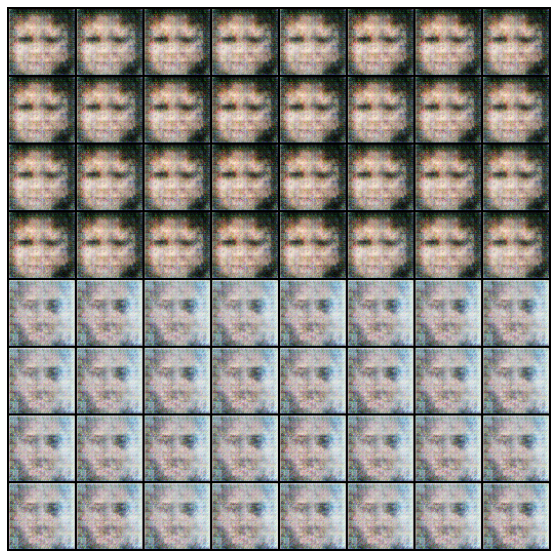

EPOCH: 2.000	d_loss: 0.488	g_loss: 4.388	(253.01s - 3542.13s remaining)


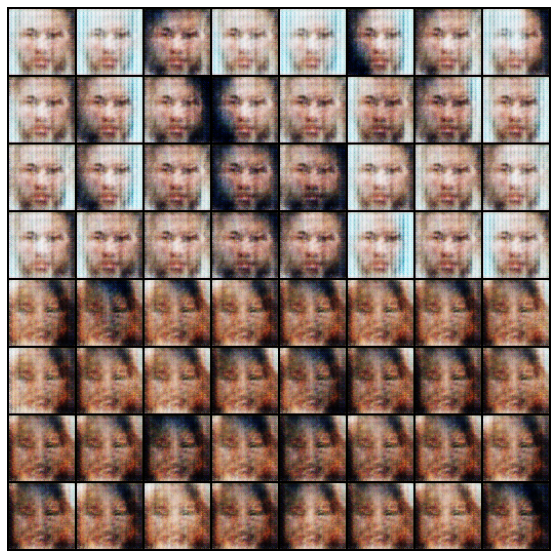

EPOCH: 3.000	d_loss: 0.455	g_loss: 5.198	(356.59s - 3209.29s remaining)


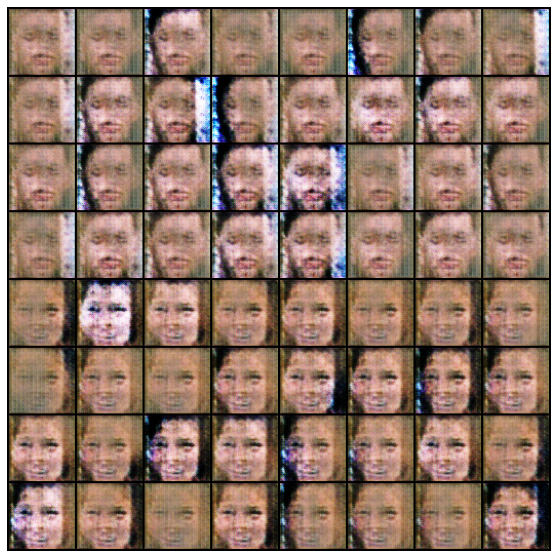

EPOCH: 4.000	d_loss: 0.342	g_loss: 5.473	(459.79s - 2988.64s remaining))


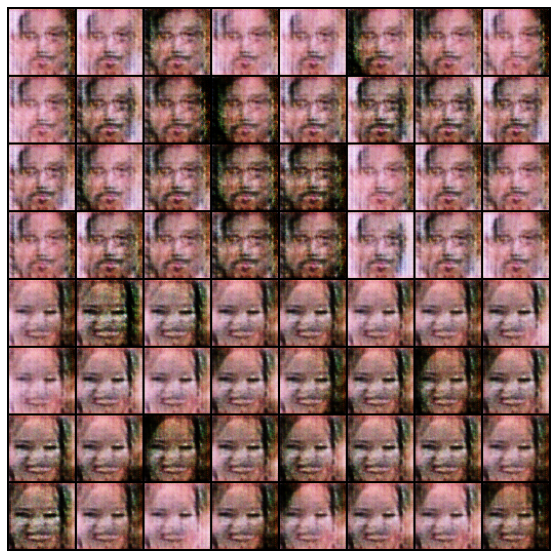

EPOCH: 5.000	d_loss: 0.374	g_loss: 6.145	(563.04s - 2815.21s remaining))


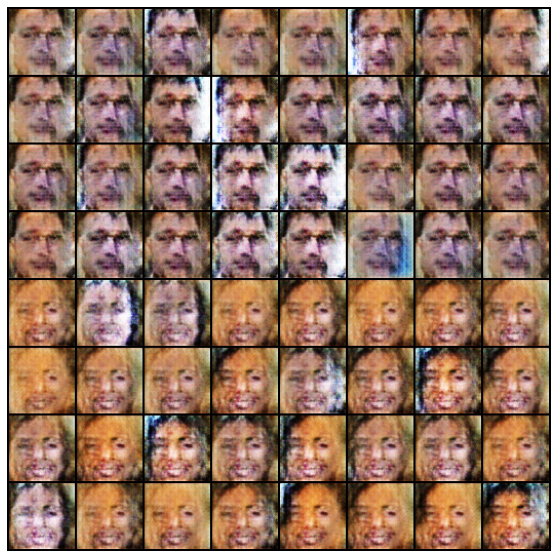

EPOCH: 6.000	d_loss: 0.372	g_loss: 5.969	(666.36s - 2665.44s remaining))


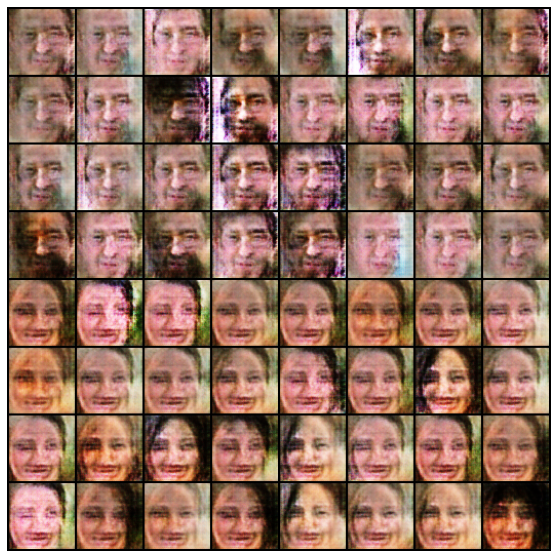

EPOCH: 7.000	d_loss: 0.385	g_loss: 6.043	(769.71s - 2529.03s remaining))


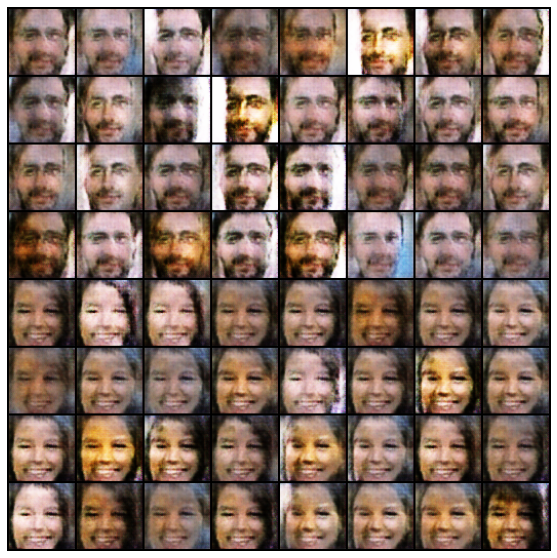

EPOCH: 8.000	d_loss: 0.419	g_loss: 5.907	(873.14s - 2401.15s remaining))


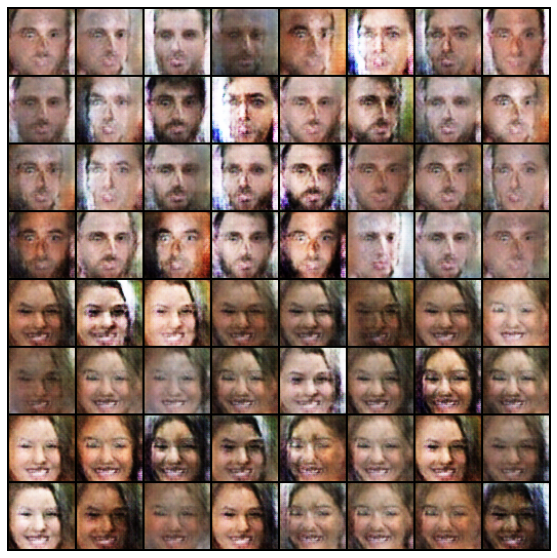

EPOCH: 9.000	d_loss: 0.401	g_loss: 5.632	(1009.48s - 2355.45s remaining))


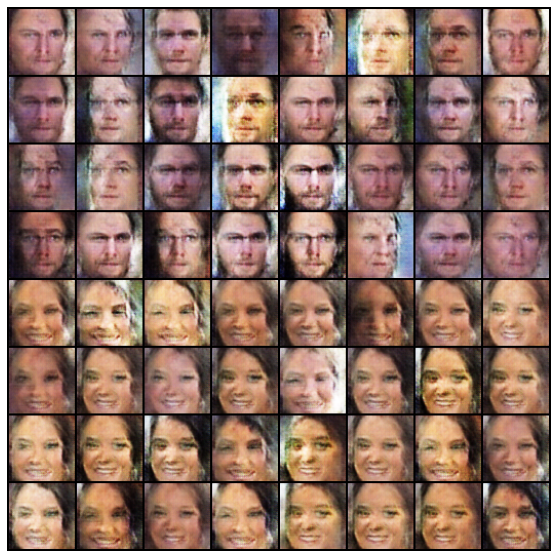

EPOCH: 10.000	d_loss: 0.406	g_loss: 5.553	(1122.51s - 2245.02s remaining)


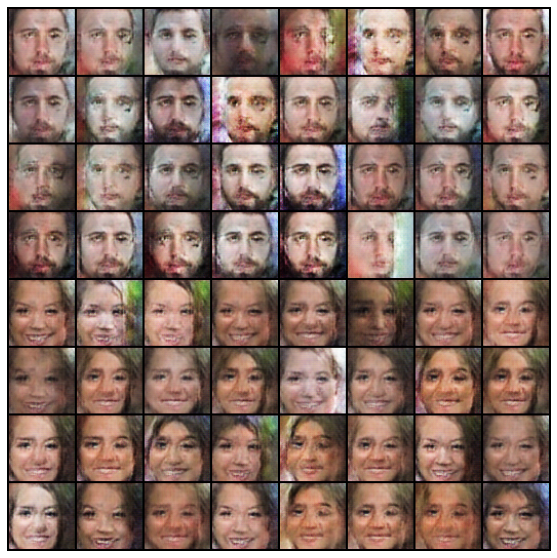

EPOCH: 11.000	d_loss: 0.381	g_loss: 5.586	(1225.36s - 2116.53s remaining))


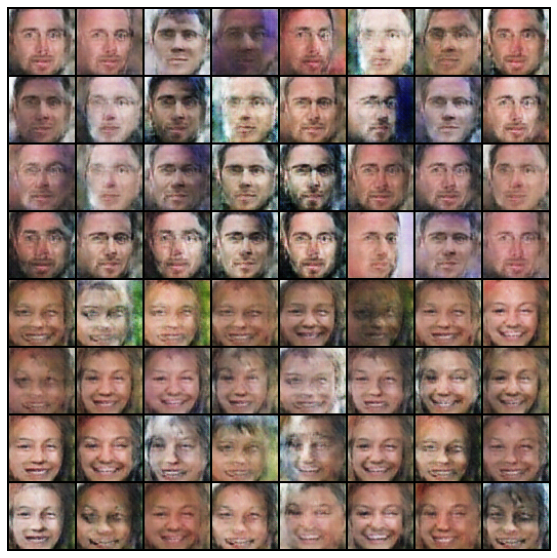

EPOCH: 12.000	d_loss: 0.337	g_loss: 6.072	(1328.42s - 1992.63s remaining))


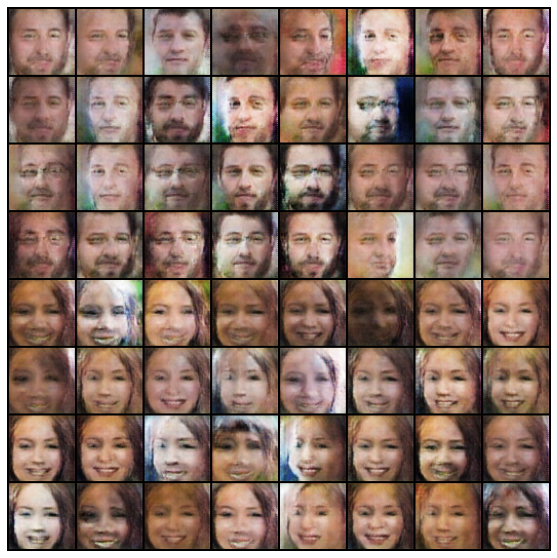

EPOCH: 13.000	d_loss: 0.398	g_loss: 5.537	(1432.51s - 1873.28s remaining))


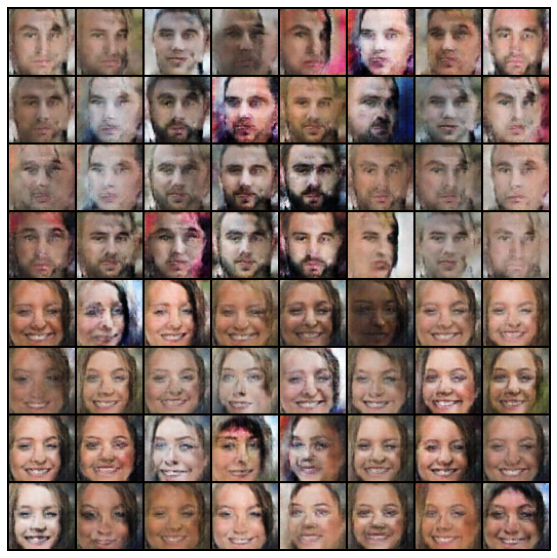

EPOCH: 14.000	d_loss: 0.363	g_loss: 5.451	(1536.72s - 1756.25s remaining))


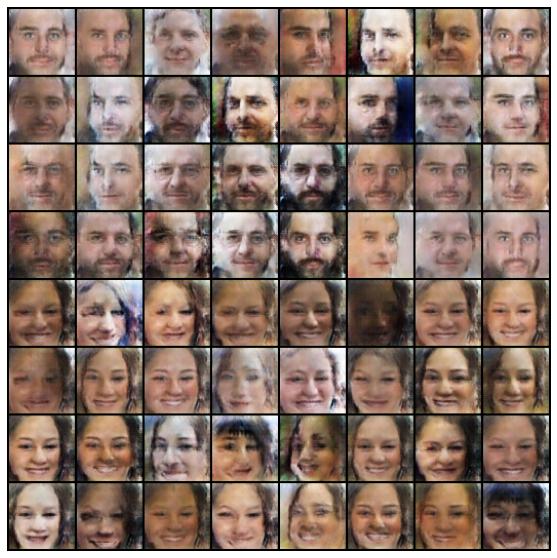

EPOCH: 15.000	d_loss: 0.370	g_loss: 5.311	(1640.94s - 1640.94s remaining))


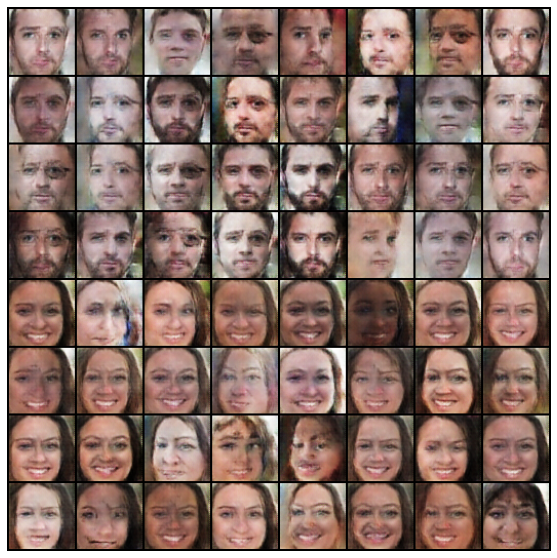

EPOCH: 16.000	d_loss: 0.357	g_loss: 5.369	(1745.09s - 1526.95s remaining))


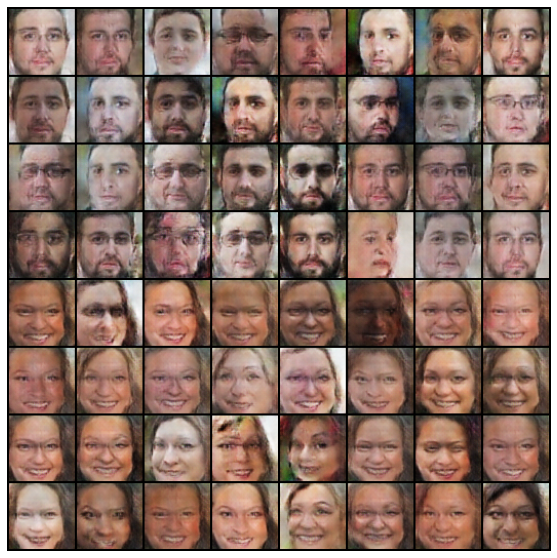

EPOCH: 17.000	d_loss: 0.377	g_loss: 5.141	(1848.40s - 1413.48s remaining))


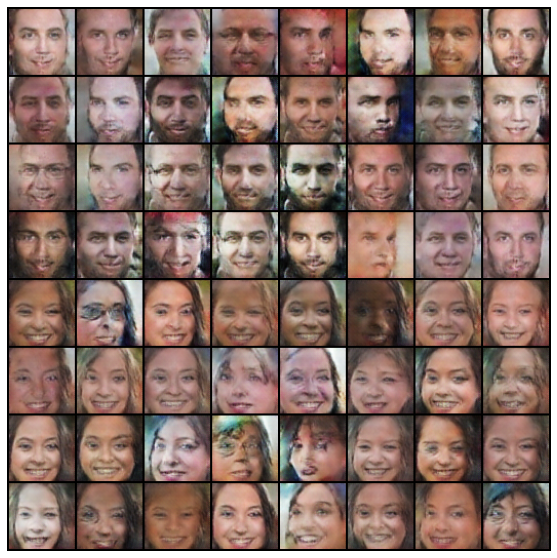

EPOCH: 18.000	d_loss: 0.364	g_loss: 5.213	(1968.42s - 1312.28s remaining))


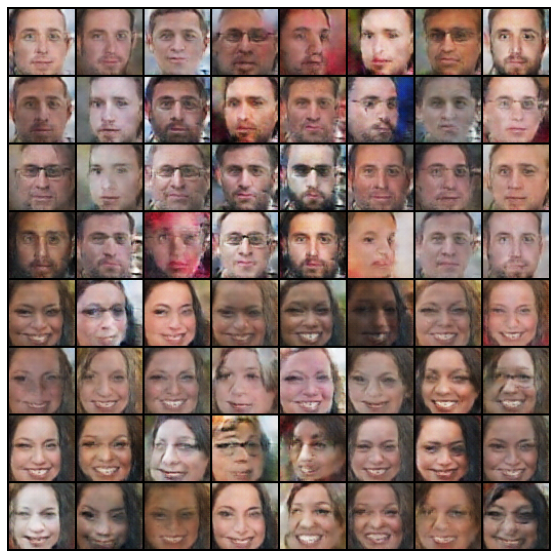

EPOCH: 19.000	d_loss: 0.338	g_loss: 5.286	(2105.96s - 1219.24s remaining))


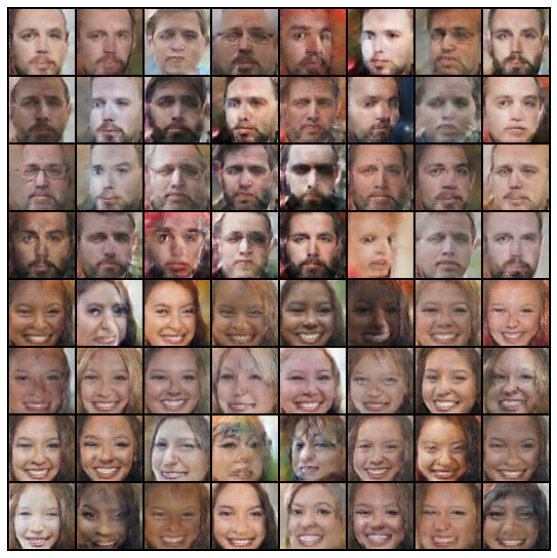

EPOCH: 20.000	d_loss: 0.375	g_loss: 4.990	(2209.44s - 1104.72s remaining))


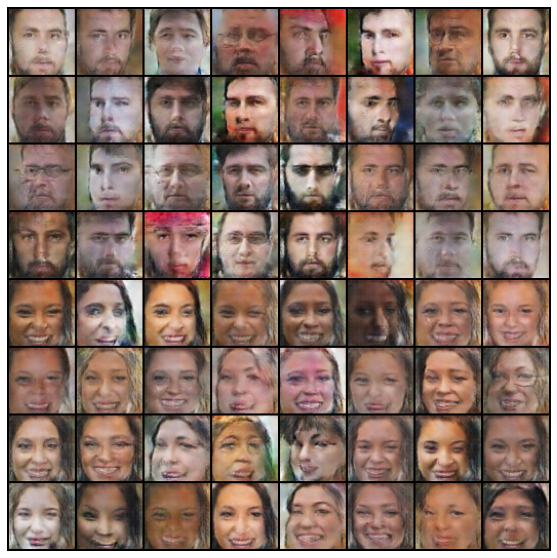

EPOCH: 21.000	d_loss: 0.360	g_loss: 4.946	(2312.59s - 991.11s remaining)))


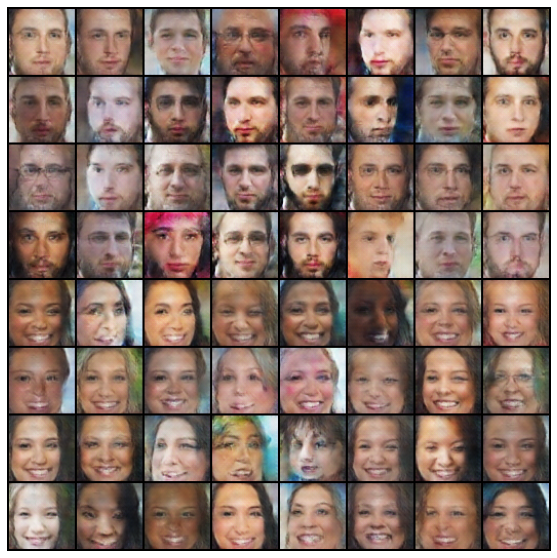

EPOCH: 22.000	d_loss: 0.369	g_loss: 4.770	(2415.87s - 878.50s remaining))


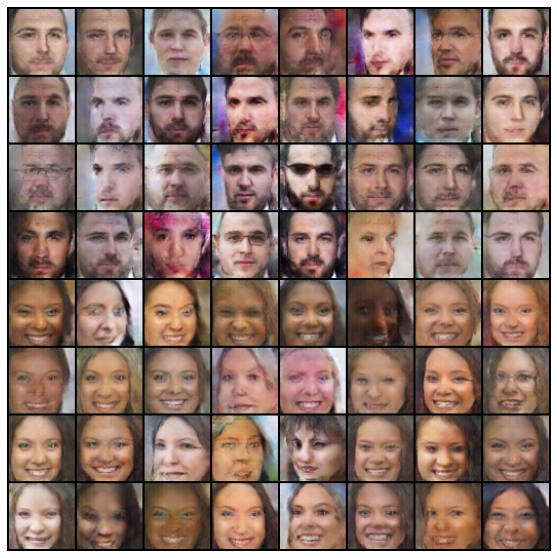

EPOCH: 23.000	d_loss: 0.363	g_loss: 4.915	(2519.31s - 766.75s remaining))


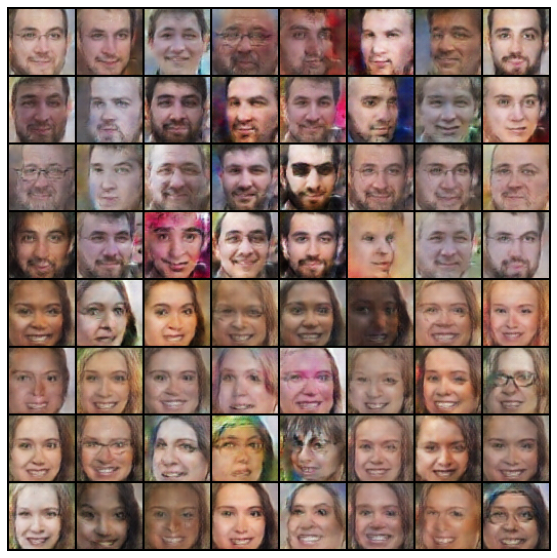

EPOCH: 24.000	d_loss: 0.346	g_loss: 4.968	(2622.58s - 655.64s remaining))


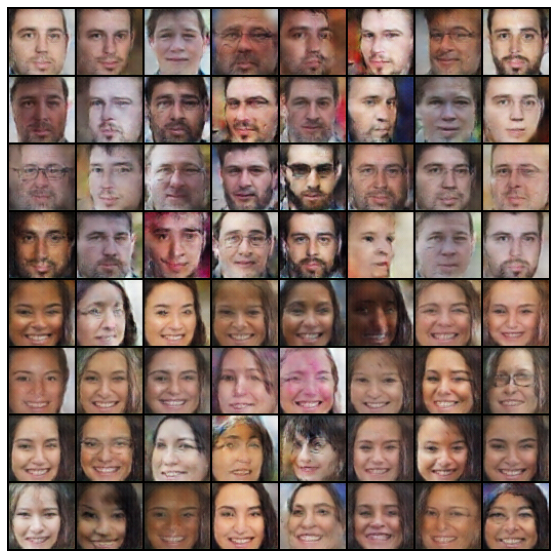

EPOCH: 25.000	d_loss: 0.363	g_loss: 4.553	(2726.48s - 545.30s remaining))


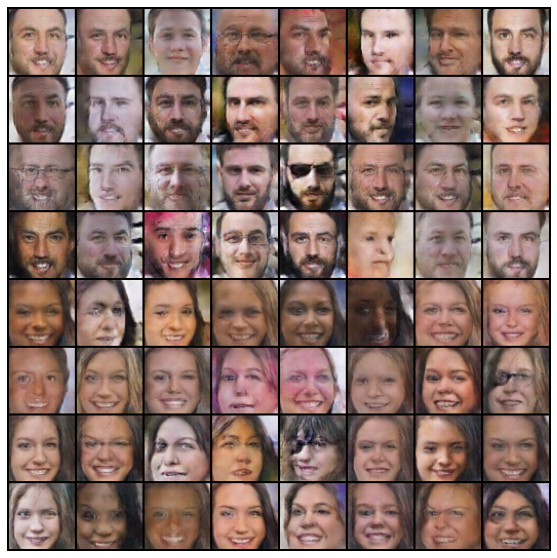

EPOCH: 26.000	d_loss: 0.311	g_loss: 4.928	(2829.73s - 435.34s remaining))


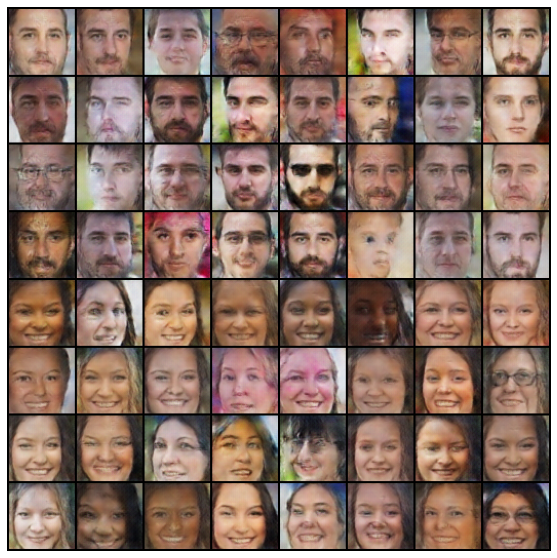

EPOCH: 27.000	d_loss: 0.385	g_loss: 4.582	(2933.10s - 325.90s remaining))


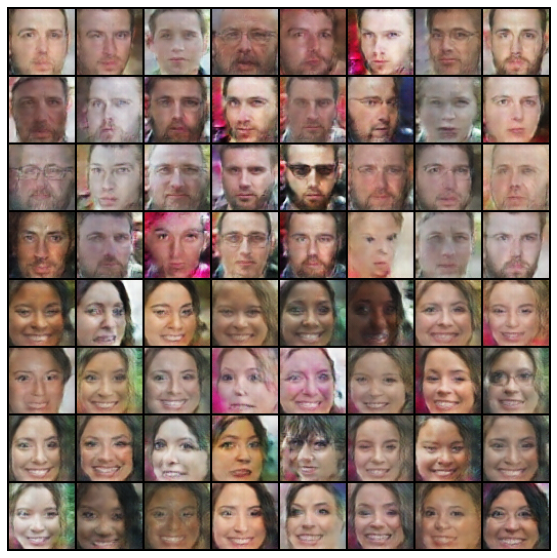

EPOCH: 28.000	d_loss: 0.359	g_loss: 4.488	(3059.71s - 218.55s remaining))


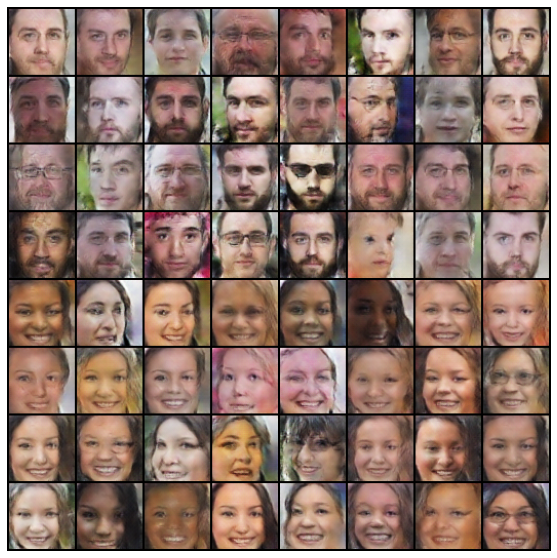

EPOCH: 29.000	d_loss: 0.275	g_loss: 5.093	(3199.20s - 110.32s remaining))


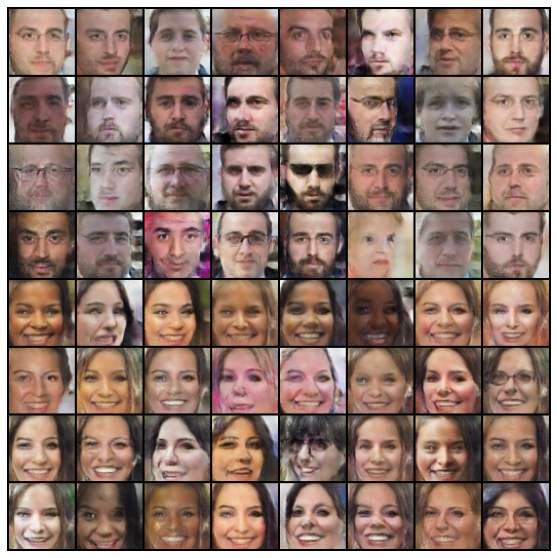

EPOCH: 30.000	d_loss: 0.362	g_loss: 4.642	(3302.78s - 0.00s remaining)))


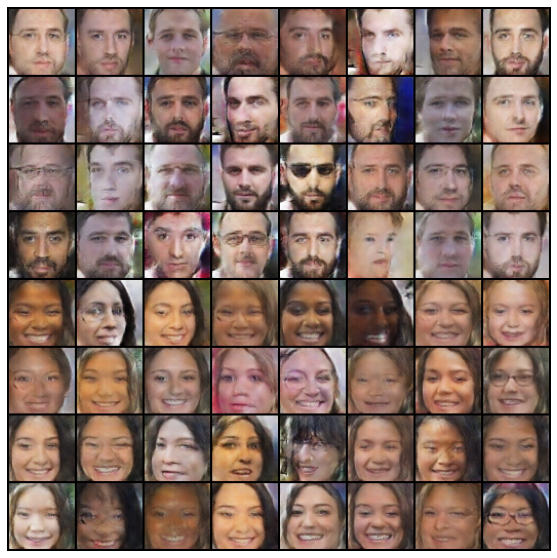

In [31]:
train_model()

Conclusion: From the preceding image, we can see that the first 32 images correspond to male
images, while the next 32 correspond to female images, which substantiates the fact
that the conditional GANs performed as expected.

### Saving and Loading the model

In [32]:
!mkdir checkpoint_CDCGANs

mkdir: cannot create directory ‘checkpoint_CDCGANs’: File exists


In [41]:
def save_checkpoint(discriminator, generator, d_optimizer, g_optimizer, epoch, save_path):
    torch.save({'discriminator_state_dict': discriminator.state_dict(),
               'generator_state_dict': generator.state_dict(),
               'd_optimizer_state_dict': d_optimizer.state_dict(),
               'g_optimizer_state_dict': g_optimizer.state_dict(),
               'epoch': epoch
               }, save_path)

In [56]:
def load_checkpoint(discriminator, generator, d_optimizer, g_optimizer, load_path):
    checkpoint = torch.load(load_path)
    discriminator.load_state_dict(checkpoint['discriminator_state_dict'])
    generator.load_state_dict(checkpoint['generator_state_dict'])
    d_optimizer.load_state_dict(checkpoint['d_optimizer_state_dict'])
    g_optimizer.load_state_dict(checkpoint['g_optimizer_state_dict'])
    epoch = checkpoint['epoch']
    
    return discriminator, generator, d_optimizer, g_optimizer, epoch

In [42]:
save_path = 'checkpoint_CDCGANs/CDCGANS.pth'

In [45]:
save_checkpoint(discriminator, generator, d_optimizer, g_optimizer, epoch=30, save_path=save_path)

In [57]:
load_checkpoint(discriminator, generator, d_optimizer, g_optimizer, save_path)

(Discriminator(
   (label_embeddings): Embedding(2, 32)
   (model): Sequential(
     (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (1): LeakyReLU(negative_slope=0.2, inplace=True)
     (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (4): LeakyReLU(negative_slope=0.2, inplace=True)
     (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (7): LeakyReLU(negative_slope=0.2, inplace=True)
     (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (10): LeakyReLU(negative_slope=0.2, inplace=True)
     (11): Conv2d(512, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 